# JPEG Experiment

### Setting up the Data

In [1]:
# Setup the dataset
# You might have to adjust the data_path in settings.py and setup.py files
!python src/data/setup.py

No. of classes used:  200
100%|█████████████████████████████████████| 11788/11788 [10:20<00:00, 19.00it/s]


### Import Modules

In [1]:
# External Imports
import os
import re
from io import BytesIO
from PIL import Image
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils, datasets
from torch.autograd import Variable
import matplotlib.pyplot as plt
import cv2
import sys
from tqdm import tqdm
import copy


# GitLab Code imports
sys.path.insert(0, './src/models/')
import src.training.train_and_test as tnt
from src.data.preprocess import mean, std
from settings import img_size, test_batch_size
from src.data.customdataset import CustomImageFolder
from src.utils.local_analysis import LocalAnalysis

# Random Seed
random_seed = 42
torch.manual_seed(random_seed)

### Prepare Data

In [2]:
# Directories
# You might have to change this directory path
directory = "/scratch/PPNet/datasets/cub200_cropped/"
directory_test = directory + "test_cropped/"

In [3]:
def JPEGcompression(image):
    """Applies JPEG compression of quality JPEG_QUALITY
    Args:
        image (PIL Image): uncompressed image
    Returns:
        Compressed Image
    """
    outputIoStream = BytesIO()
    image.save(outputIoStream, "JPEG", quality=JPEG_QUALITY, optimice=True)
    outputIoStream.seek(0)
    return Image.open(outputIoStream)

In [4]:
normalize = transforms.Normalize(mean=mean, std=std)


# Test data, where 50% of the images are uncompressed and the other 
# 50% of the images are compressed. It is processed in the CustomImageFolder class
test_dataset = CustomImageFolder(
    directory_test,
    transform= transforms.Compose([   
            transforms.Resize(size=(img_size, img_size)),
            transforms.ToTensor(),
            normalize,
        ]),
    target_specific_transform= transforms.Compose([
        transforms.Lambda(JPEGcompression) # Apply JPEG compression as transform
    ]))

test_loader = torch.utils.data.DataLoader(
    test_dataset, batch_size=test_batch_size, shuffle=False,
    num_workers=4, pin_memory=False)


# Test data, where are the images are uncompressed
test_dataset_all_clean = datasets.ImageFolder(
    directory_test,
    transforms.Compose([ 
            transforms.Resize(size=(img_size, img_size)),
            transforms.ToTensor(),
            normalize,
        ]))

test_loader_all_clean = torch.utils.data.DataLoader(
    test_dataset_all_clean, batch_size=test_batch_size, shuffle=False,
    num_workers=4, pin_memory=False)

### Load Model

Model Paths:

- ResNet18 - jpeg_saved_models/resnet18/002/10_19push0.8019.pth
- ResNet34 - jpeg_saved_models/resnet34/002/10_18push0.8214.pth
- VGG19 - jpeg_saved_models/vgg19/002/10_19push0.8108.pth

In [5]:
# Select Network, and specify Experiment run
base_architecture = 'resnet34' #'resnet34', 'vgg19'
experiment_run = '002'

# Model directory
load_model_dir = '/cluster/scratch/rarade/PPNet/jpeg_saved_models/{}/002/'.format(base_architecture)
load_model_name = '10_18push0.8214.pth'

# Specify the folder to save the images and logs
save_dir = '/cluster/scratch/rarade/PPNet/jpeg_analysis_top5/' + base_architecture + '/' + experiment_run + '/'
! mkdir -p {save_dir}

In [6]:
loc_analysis = LocalAnalysis(load_model_dir, load_model_name, "", image_save_directory = save_dir)

load model from /cluster/scratch/rarade/PPNet/jpeg_saved_models/resnet34/002/10_18push0.8214.pth
model base architecture: resnet34
experiment run: 002
Prototypes are chosen from 200 number of classes.
Their class identities are: [  0   0   0 ... 199 199 199]
All prototypes connect most strongly to their respective classes.


### Check Model Performance

In [7]:
JPEG_QUALITY = 20

protopnet = loc_analysis.ppnet_multi

print("Accuracy on test data set with half the classes being jpeg compressed and the other half uncompressed")
tnt.test(model=protopnet, dataloader=test_loader, 
         class_specific=loc_analysis.class_specific, 
         log=loc_analysis.log)
print("")

print("Accuracy on test data set with no jpeg compressed classes")
tnt.test(model=protopnet, dataloader=test_loader_all_clean, 
         class_specific=loc_analysis.class_specific, 
         log=loc_analysis.log)
print("")

Accuracy on test data set with half the classes being jpeg compressed and the other half uncompressed
	test
	time: 	10.54524564743042
	cross ent: 	1.002437913212283
	cluster: 	0.13556254982691388
	separation:	0.2775981517444397
	avg separation:	3.376396598487065
	accu: 		82.136693130825%
	l1: 		2015.1351318359375
	p dist pair: 	5.413360118865967

Accuracy on test data set with no jpeg compressed classes
	test
	time: 	10.143678188323975
	cross ent: 	3.6730348837786706
	cluster: 	0.5228665429970314
	separation:	0.26285051888433
	avg separation:	3.536148844094112
	accu: 		46.11667241974457%
	l1: 		2015.1351318359375
	p dist pair: 	5.413360118865967



### Visualize Prototypes

Each example lists the top 5 prototypes and corresponding details for JPEG compressed image (left) and original image (right).

JPEG compressed image
Predicted: 1	 Actual: 1	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 70	 Actual: 1	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0               17    1               1         4.380757          707    1   
1               14    2               1         2.840838          701    2   
2               18    3               1         1.923967          609    3   
3               15    4               1         1.595643          607    4   
4               13    5               1         1.532780          602    5   

                                    
  Prototype Class Similarity Score  
0              70         2.366136  
1              70         2.232909  
2              60         1.485155  
3              60         1.437467  
4              60         1.407002

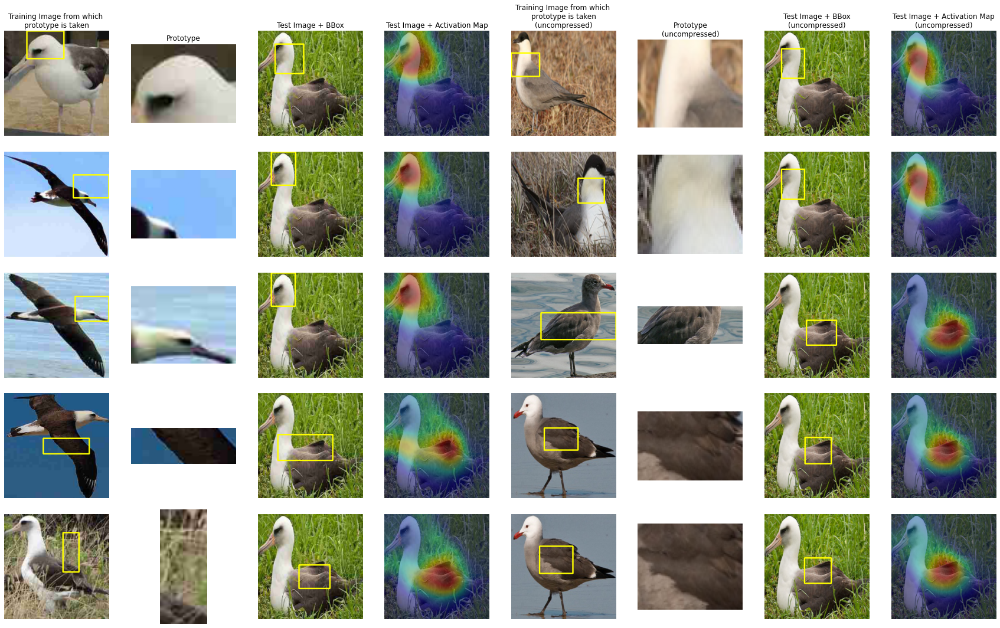

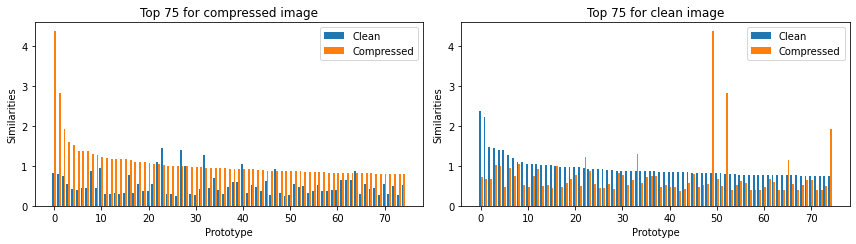


JPEG compressed image
Predicted: 21	 Actual: 21	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 104	 Actual: 21	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0              217    1              21         7.388249         1046    1   
1              216    2              21         5.906692         1042    2   
2              212    3              21         4.807253         1040    3   
3              218    4              21         3.346301         1045    4   
4              215    5              21         3.098536         1044    5   

                                    
  Prototype Class Similarity Score  
0             104         3.865208  
1             104         3.366794  
2             104         3.224727  
3             104         2.407087  
4             104         1.688193

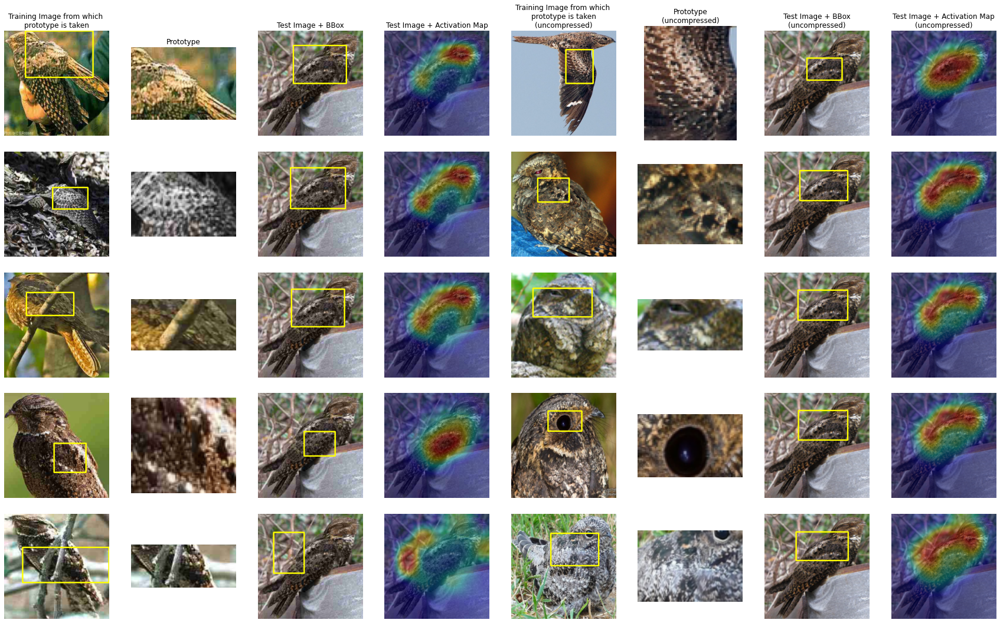

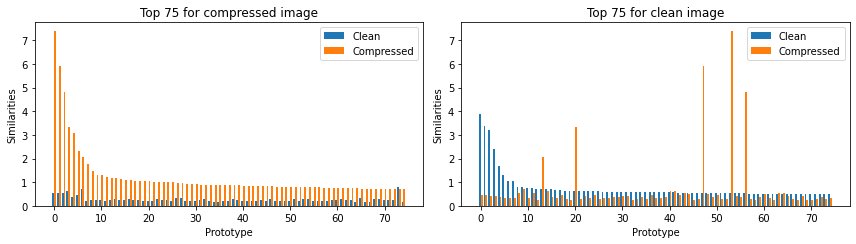


JPEG compressed image
Predicted: 41	 Actual: 41	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 34	 Actual: 41	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0              411    1              41         1.967386          344    1   
1              410    2              41         1.912022          162    2   
2              413    3              41         1.554932          340    3   
3              419    4              41         1.535479          343    4   
4              417    5              41         1.458696          348    5   

                                    
  Prototype Class Similarity Score  
0              34         1.462963  
1              16         1.433557  
2              34         1.370808  
3              34         1.347485  
4              34         1.347485

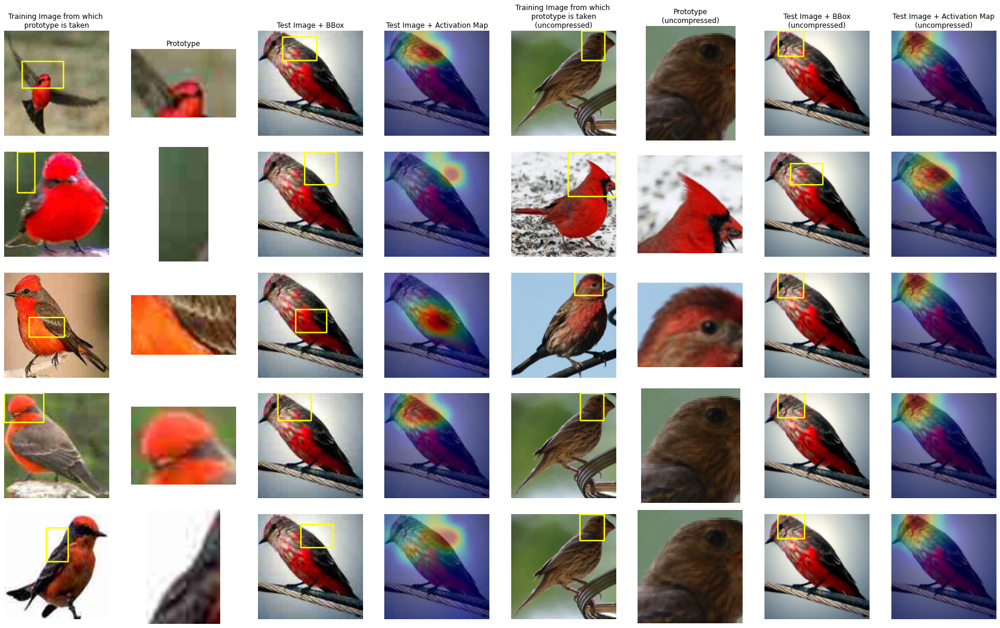

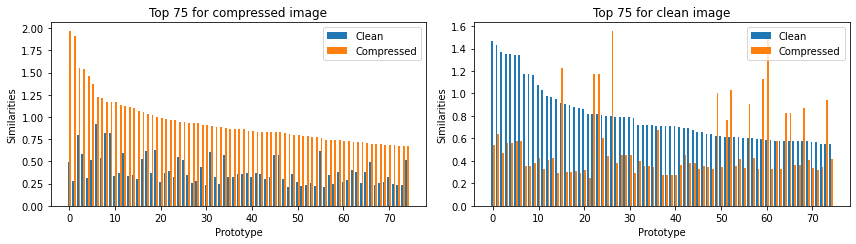


JPEG compressed image
Predicted: 145	 Actual: 61	 Prediction is wrong.
------------------------------
Uncompressed image
Predicted: 58	 Actual: 61	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1455    1             145         3.883883          588    1   
1             1458    2             145         2.434498         1008    2   
2              651    3              65         2.289252          463    3   
3              614    4              61         1.670086          589    4   
4              618    5              61         1.398218         1287    5   

                                    
  Prototype Class Similarity Score  
0              58         1.587408  
1             100         1.422541  
2              46         1.333463  
3              58         1.174609  
4             128         1.115989

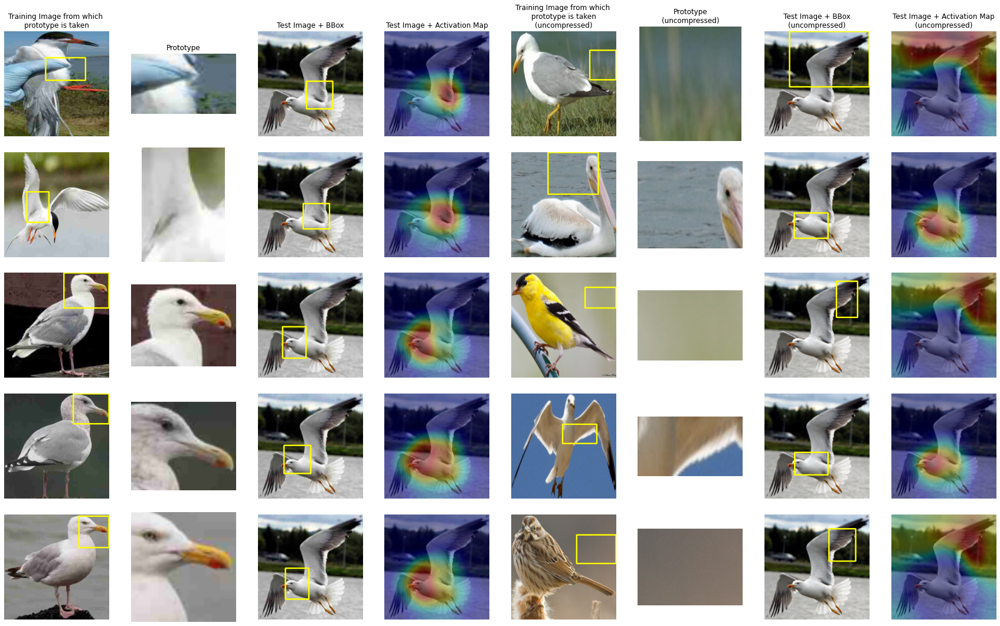

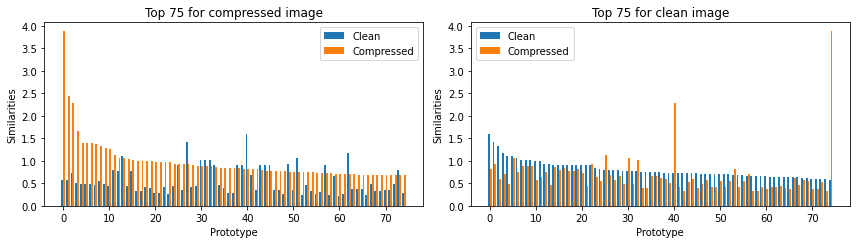


JPEG compressed image
Predicted: 81	 Actual: 81	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 78	 Actual: 81	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0              811    1              81         2.868378          785    1   
1              818    2              81         2.590858          787    2   
2              816    3              81         2.580770          780    3   
3              810    4              81         2.096216          781    4   
4              819    5              81         2.062207          789    5   

                                    
  Prototype Class Similarity Score  
0              78         3.592371  
1              78         3.567284  
2              78         2.971038  
3              78         2.678423  
4              78         1.756868

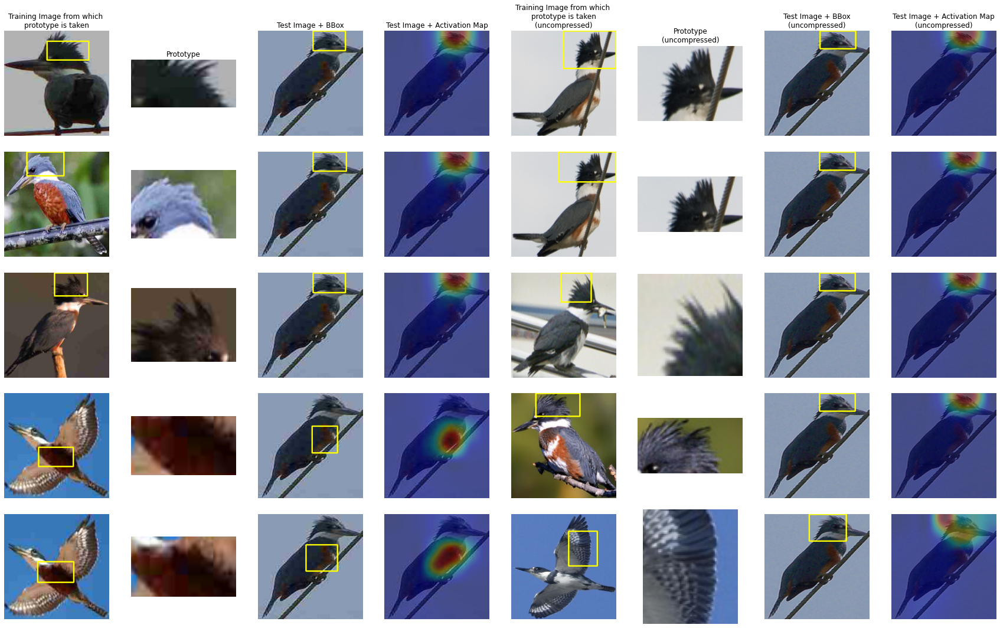

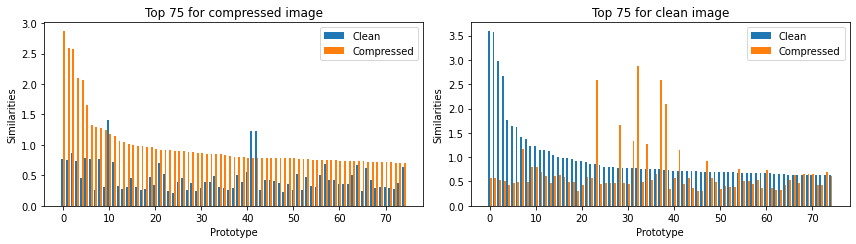


JPEG compressed image
Predicted: 101	 Actual: 101	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 38	 Actual: 101	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1479    1             147         4.980587         1025    1   
1             1476    2             147         3.431448          363    2   
2             1016    3             101         3.014902          380    3   
3              777    4              77         2.737090         1082    4   
4             1019    5             101         2.653672          384    5   

                                    
  Prototype Class Similarity Score  
0             102         3.304786  
1              36         3.251744  
2              38         2.642874  
3             108         2.432254  
4              38         2.146679

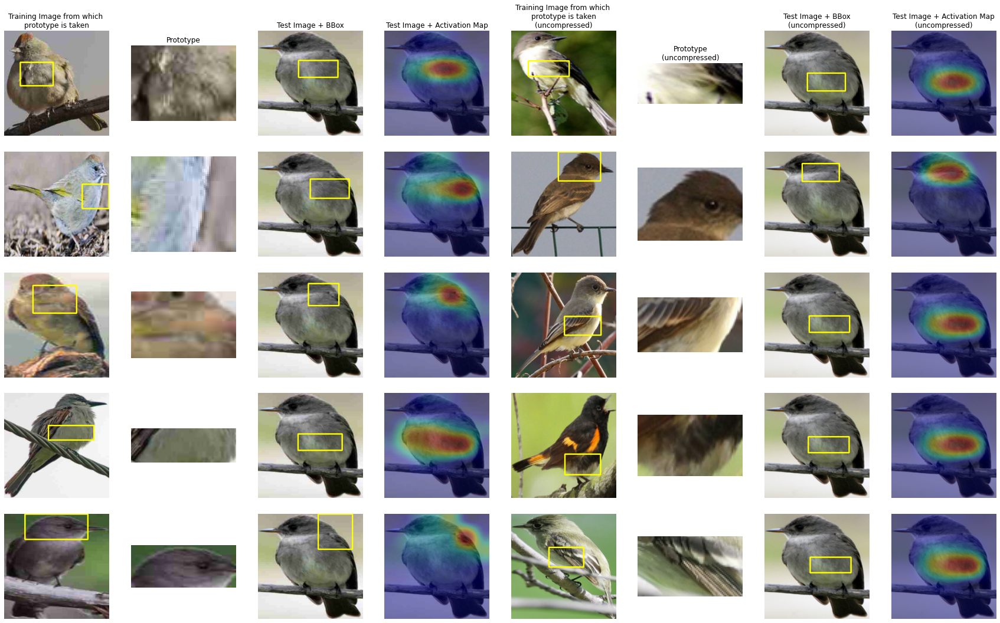

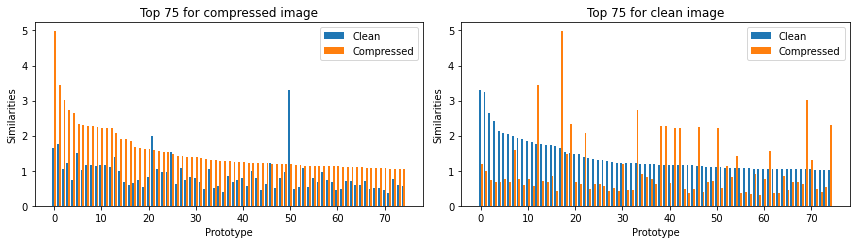


JPEG compressed image
Predicted: 121	 Actual: 121	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 121	 Actual: 121	 Prediction is correct.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1218    1             121         6.430284         1218    1   
1             1214    2             121         4.477217         1214    2   
2             1212    3             121         3.247473         1212    3   
3             1219    4             121         2.053570         1219    4   
4             1701    5             170         1.597679         1701    5   

                                    
  Prototype Class Similarity Score  
0             121         3.375285  
1             121         2.878112  
2             121         2.748161  
3             121         2.266793  
4             170         1.786523

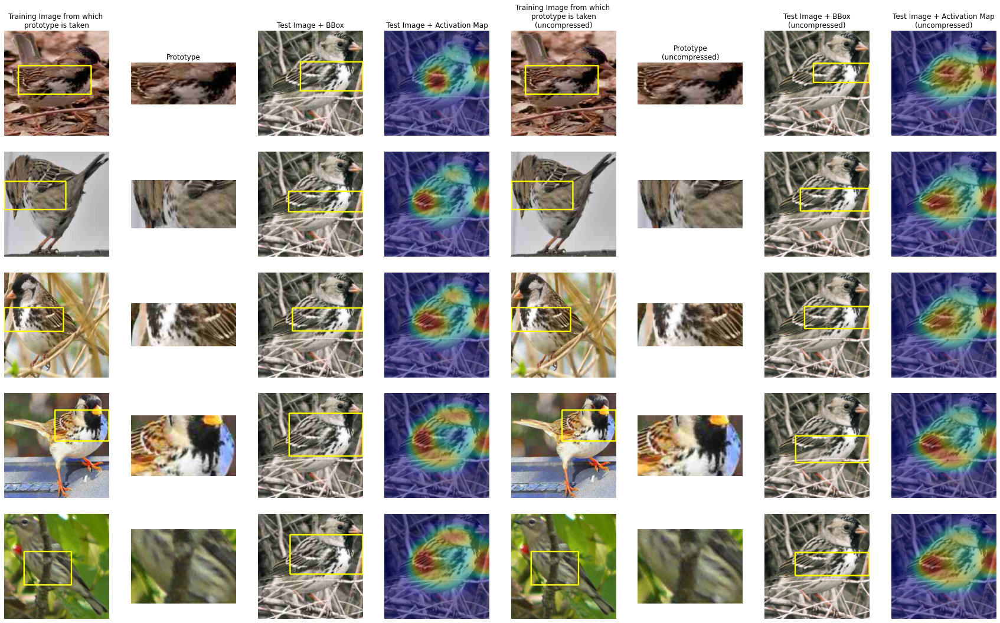

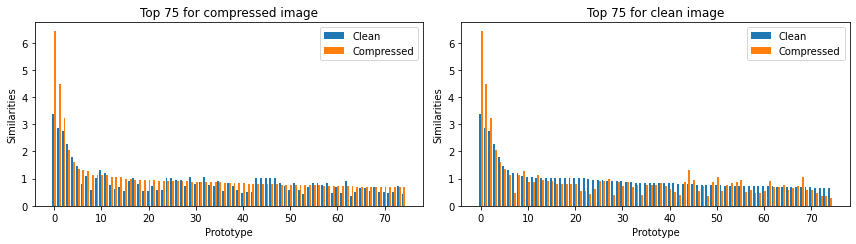


JPEG compressed image
Predicted: 145	 Actual: 141	 Prediction is wrong.
------------------------------
Uncompressed image
Predicted: 146	 Actual: 141	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1452    1             145         2.313285         1468    1   
1             1454    2             145         2.097793         1464    2   
2             1455    3             145         1.767604         1107    3   
3              599    4              59         1.693466         1105    4   
4              595    5              59         1.688056         1460    5   

                                    
  Prototype Class Similarity Score  
0             146         1.967386  
1             146         1.924082  
2             110         1.521571  
3             110         1.415897  
4             146         1.408728

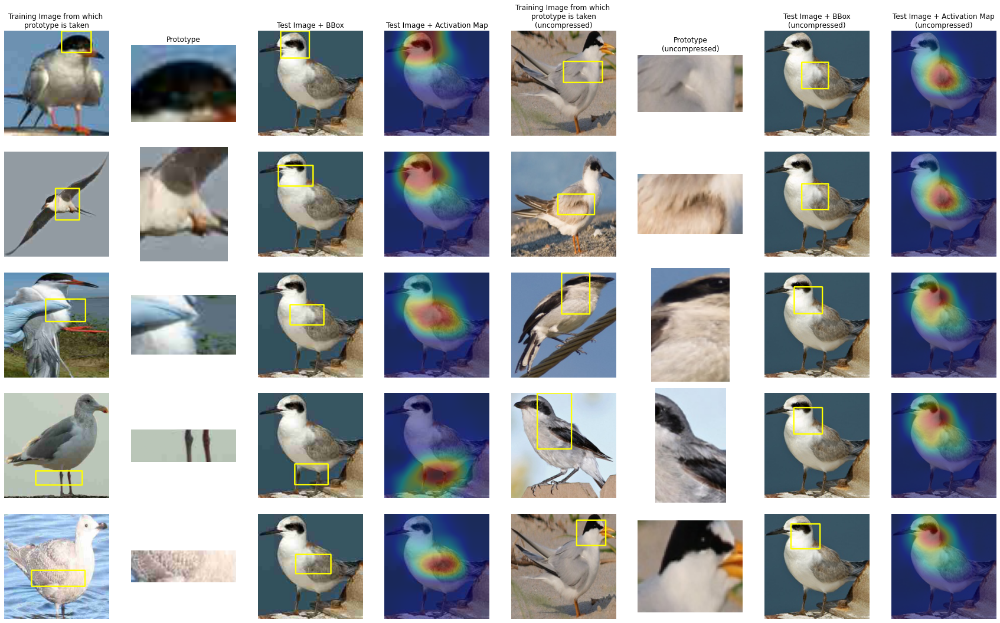

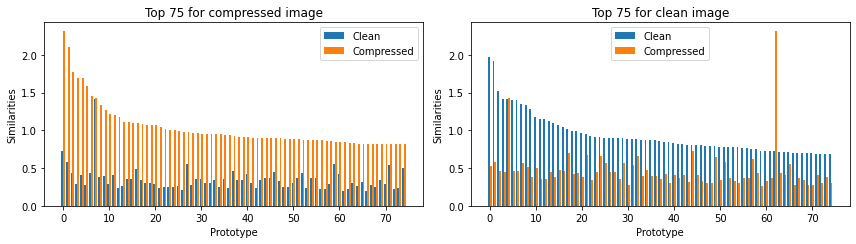


JPEG compressed image
Predicted: 161	 Actual: 161	 Prediction is correct.
------------------------------
Uncompressed image
Predicted: 168	 Actual: 161	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1616    1             161         3.092312         1686    1   
1             1612    2             161         2.711671         1680    2   
2             1614    3             161         2.535538         1687    3   
3             1613    4             161         2.411482         1689    4   
4             1610    5             161         1.953563         1186    5   

                                    
  Prototype Class Similarity Score  
0             168         2.022215  
1             168         2.022215  
2             168         1.586487  
3             168         1.521625  
4             118         1.270826

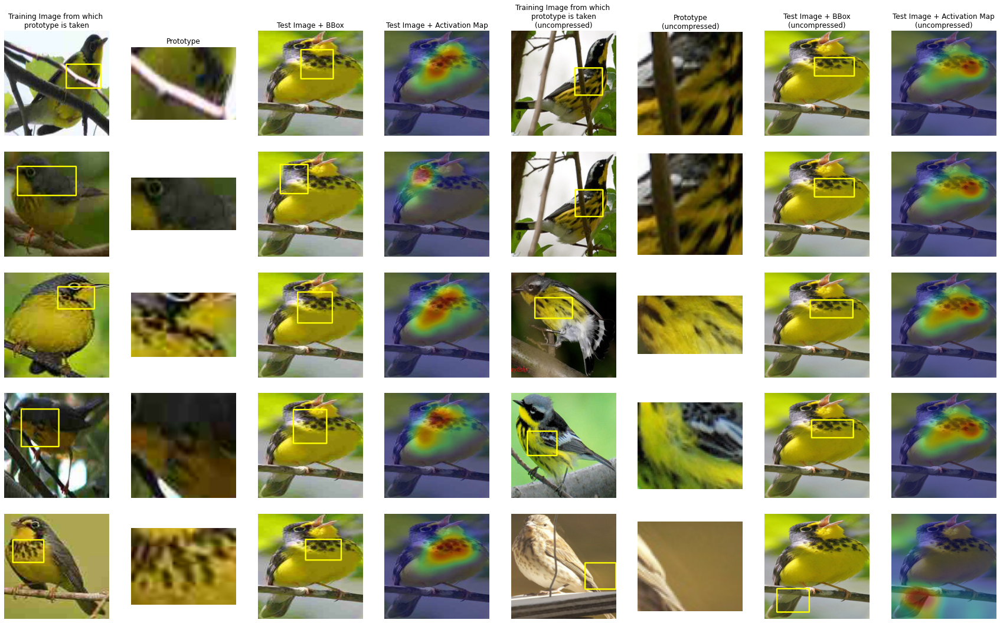

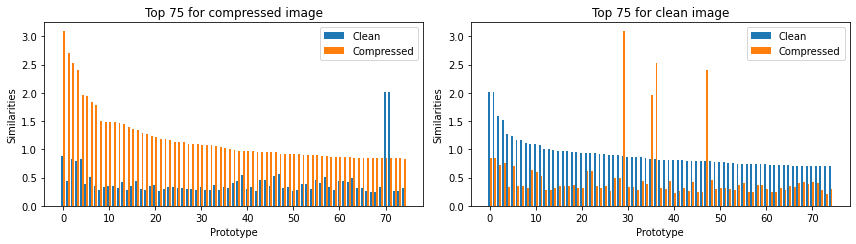


JPEG compressed image
Predicted: 173	 Actual: 181	 Prediction is wrong.
------------------------------
Uncompressed image
Predicted: 174	 Actual: 181	 Prediction is wrong.
------------------------------


Compressed Image                                        Clean Image       \
      Prototype Id Rank Prototype Class Similarity Score Prototype Id Rank   
0             1754    1             175         2.555156         1574    1   
1             1574    2             157         2.465424         1749    2   
2             1756    3             175         2.187209         1566    3   
3             1736    4             173         2.130775         1628    4   
4              330    5              33         1.553405         1201    5   

                                    
  Prototype Class Similarity Score  
0             157         1.950339  
1             174         1.781616  
2             156         1.727931  
3             162         1.513858  
4             120         1.398411

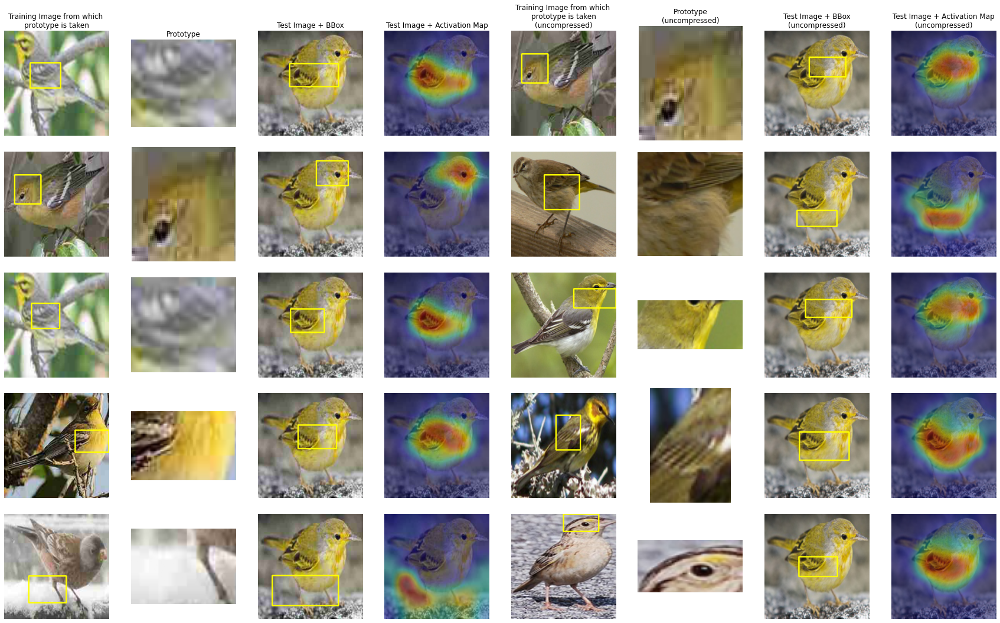

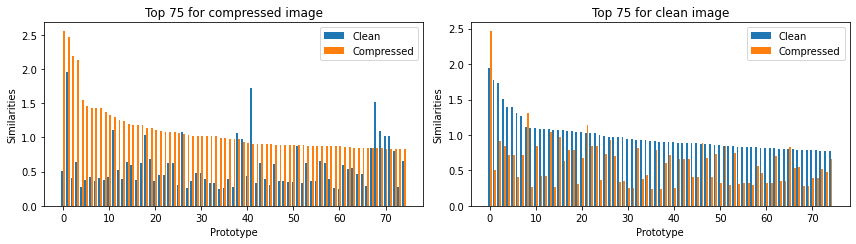

In [8]:
JPEG_QUALITY = 20

# Retrieve test data classes
classes = sorted(os.listdir(directory_test))

sample_images = 10

# Loop over every fourth class, which has also been compressed during training
for i in range(sample_images):
    # Calculate the test image label
    test_image_label = (len(classes)//sample_images)*i+1

    # Choose an odd class: that's why we add +1 in the index
    # If we don't add 1, then we only inspect even classes, and we can see the inverse effect
    test_image_dir = directory_test+classes[(len(classes)//sample_images)*i+1]
    image_list = os.listdir(test_image_dir)
    
    # Index for test images
    j = 1
    test_image_path = os.path.join(test_image_dir, image_list[j])

    # Compression Processing Pipeline
    preprocess_corrupted = transforms.Compose([
                transforms.Lambda(JPEGcompression),
                transforms.Resize(size=(img_size, img_size)),
                transforms.ToTensor(),
                normalize,
            ])
    
    # Normal Processing Pipeline
    preprocess_clean = transforms.Compose([
                transforms.Resize(size=(img_size, img_size)),
                transforms.ToTensor(),
                normalize,
            ])

    img_pil = Image.open(test_image_path)

    # Show the results
    loc_analysis.jpeg_visualization2(img_pil, image_list[j].split(".")[0], 
                                     test_image_label,
                                     preprocess_clean, preprocess_corrupted, 
                                     show_images=True, max_prototypes=5)
    print("============================================================================================")
    print("")